****
# Climate Change and Coral Reefs
****

# Table of contents <a name="contents"></a>
- [Introduction](#introduction)

- [A Global Overview of Coral Bleaching](#part1)

- [A Closer Look at The Climate](#part2)

- [Social Effects of Coral Bleaching](#part3)

- [Case Study: Great Barrier Reef](#part4)

- [Discussion and Conlusions](#part5)

- [References](#references)

## Introduction <a name="introduction"></a>

[Table of Contents](#contents)

****

Coral reefs are the most diverse and complex marine ecosystem and comprise the largest biological structure on the earth. For most people, they are a place of vibrant colors, high biodiversity and full of life. Recently, however, coral reefs have been facing increasing hazards and threats and many coral habitats worldwide have been declining rapidly.

Coral mortality, in the form of coral bleaching, is one of the worst problems for ocean biodiversity and climate. The ever-increasing level of carbon dioxide in the atmosphere causes rising temperatures, which in turn causes [ocean acidification](https://www.noaa.gov/education/resource-collections/ocean-coasts/ocean-acidification), impacting both fishes and coral reefs across the globe. As the human population of the Earth continues to grow and the effects of climate change become more prevalent, it would be expected to witness even worse conditions for coral reefs and marine life. This would in turn come back to bite humans, as disappearance of corals would also have impact in fishing and tourism activities. Declining coral diversity and fish population, therefore, would have an effect on all living things and would be a recipe for disaster.

The UN's 13th goal of [Sustainable Development](https://sdgs.un.org/goals) of below 2 degrees increase in temperature in the next 50 years will be impossible to withhold unless something drastic is done in the next [three years](https://www.irishtimes.com/news/environment/just-three-years-left-to-stop-worst-of-global-warming-un-body-warns-1.4844623).

This article will showcase the problem at hand and the correlations between climate change, with a perspective on tourism and fishing to understand the implications of coral reefs decline and what is to be expected in the coming years.

### What is coral bleaching?

Most reef-forming corals contain symbiotic microscopic algae (zooxanthellae), which under usual conditions provide up to 90% of the energy requirement of corals. Certain environmental conditions, however, can provoke stress to the corals, and their stress response results in these algae being expelled from the coral host. Zooxanthellae contain colorful pigments, and their departure reveals the coral's white underlying calcium carbonate skeleton through the translucent tissue - the coral appears “bleached”. The images below are of a normal coral (left) and a bleached coral (right), showing the drastic change in appearance caused by coral stress.

![Coral bleaching - before and after](https://cdn.climatechangenews.com/files/2015/10/Coral-bleaching-7.jpg)

Environmental stressors including low salinity, unusually cold temperature and increased exposure to light can result in localized [coral bleaching](https://www.researchgate.net/publication/290190489_Validation_of_Reef-Scale_Thermal_Stress_Satellite_Products_for_Coral_Bleaching_Monitoring). However, mass coral bleaching events have been linked to warm oceanic temperature anomalies, which occur on the scale of hundreds to thousands of kilometers, when ambient water temperatures exceed the coral's tolerance level. Such bleaching has an impact on the animal habitats as the symbiotic system is made vulnerable and in some cases destroyed.


### Data used in our research

Datasets have been gathered from the NOAA, National Oceanic and Atmosphere Administration, which runs several services useful for our investigation. One of them -Coral Reef Watch- provides information on sea surface temperature. Comparison of these temperatures with long-term monthly climatology enables emission of bleaching alerts for coral reefs at their locations. Another dataset -Simple Ocean Data Assimilation (SODA)- aims to reconstruct the physical and biogeochemical history of the ocean, and has data of ph-level, co2 and other factors on a global scale. From these datasets we have analysed the years from 1986 all the way up to 2020, as those are the years were the data is found in complete form.

Additional datasets, to study the socioeconomic impact of the topic, have been gathered from other sources. The most voluminous ones was the Global Fisheries Landing dataset, which is consolidated from several sources and measures the annual tonnage of fishing in several locations up to the year 2015. A "socioeconomic dependence" dataset shows a snapshot from 2011 of consolidated data measuring the level of dependence and vulnerability of countries and territories which have coral reefs. One of the latest sections in this research will focus on the Great Barrier Reef in Australia, so tourism data will be used to measure the socioeconomic impact for that region.

This article is mostly interactive, as it lets you explore the general trends and correlations, while zooming into specific coral reef locations to showcase the problem at hand. In the map below, you can see the stations where temperature readings have been gathered from. Feel free to explore the map by zooming in and taking a closer look.

In [ ]:
#@title geopandas
#!pip install --upgrade geopandas

In [ ]:
#@title Load Packages
# Get important modules

# Data tools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Geoplot
import folium
from folium import plugins
#import geopandas as gpd
#import pyproj
#import plotly.express as px

# Bokeh
import bokeh.palettes
from bokeh.tile_providers import CARTODBPOSITRON, WIKIMEDIA, ESRI_IMAGERY, get_provider
from bokeh.plotting import figure
from bokeh.io import show, output_notebook, reset_output
from bokeh.layouts import row, column
from bokeh.models import  ColumnDataSource, Legend,  HoverTool, Tabs, Panel, LinearAxis, Range1d
import bokeh.io
bokeh.io.output_notebook()
# Bokeh in Colab: https://colab.research.google.com/github/pytrain/iViz/blob/master/IV_Bokeh.ipynb#scrollTo=ic9ZMeNSgAGI

import warnings
warnings.filterwarnings('ignore')

In [ ]:
#@title Load Data
from google.colab import drive
drive.mount('/content/drive')

dataPath = 'drive/My Drive/Colab Notebooks/Visualization Datasets/'

#NOAA Dataset (bleaching alerts)
df_noaa = pd.read_csv(r''+dataPath+'noaa_data.txt', delimiter='\t')

#Alkalinity/C02 dataset
df_oceanSODA = pd.read_csv(r''+dataPath+'OceanSODA-ETHZ-revised.csv', delimiter=',', usecols = ['lat', 'lon', 'time', 'ph_total', 'talk', 'co2', 'temperature']).dropna()

#Global fisheries catch dataset (industrial and non-industrial)
df_gfc_ind = pd.read_csv(r''+dataPath+'gfc_data_industrial.csv')
df_gfc_nind = pd.read_csv(r''+dataPath+'gfc_data_non_industrial.csv')

#Coral reef social vulnerability dataset
#gdf_social = gpd.read_file(dataPath+"Social_Vulnerability.shp")

#Great Barrier Reef Marine Park tourism numbers
df_tourism_gbr = pd.read_csv(r''+dataPath+'GBR_Tourism_Data.txt', delimiter='\t')

In [ ]:
#@title Prepare Data

#Preparing Alkalinity/C02 dataset
years = []
for date in df_oceanSODA["time"]:
  years.append(date[0:4])

months = []
for date in df_oceanSODA["time"]:
  months.append(date[5:7])

df_oceanSODA["year"] = years
df_oceanSODA["month"] = months

#Preparing NOAA dataset
df_noaa['Timestamp'] = pd.to_datetime(dict(year=df_noaa.YYYY, month=df_noaa.MM, day=df_noaa.DD))
df_noaa = df_noaa[(df_noaa['Timestamp'] >= '1986-01-01') & (df_noaa['Timestamp'] < '2021-01-01')]

#Preparing alerts data for Bokeh
avg_ph = []; avg_talk = []; avg_co2 = []; avg_temp = [];
for year in df_oceanSODA["year"].unique():
  temp_df = df_oceanSODA[df_oceanSODA["year"] == year]
  avg_ph.append(temp_df["ph_total"].mean())
  avg_talk.append(temp_df["talk"].mean())
  avg_co2.append(temp_df["co2"].mean())
  avg_temp.append(temp_df["temperature"].mean())

df_avg = pd.DataFrame({"avg_ph": avg_ph, "avg_talk": avg_talk, "avg_co2": avg_co2, "avg_temp": avg_temp, "year": df_oceanSODA["year"].unique()})

avg_ph = []; avg_talk = []; avg_co2 = []; avg_temp = [];
for month in df_oceanSODA["month"].unique():
  temp_df = df_oceanSODA[df_oceanSODA["month"] == month]
  avg_ph.append(temp_df["ph_total"].mean())
  avg_talk.append(temp_df["talk"].mean())
  avg_co2.append(temp_df["co2"].mean())
  avg_temp.append(temp_df["temperature"].mean())

df_avg_month = pd.DataFrame({"avg_ph": avg_ph, "avg_talk": avg_talk, "avg_co2": avg_co2, "avg_temp": avg_temp, "month":df_oceanSODA["month"].unique() })

bal0 = []; bal1 = []; bal2 = []; bal3 = []; bal4 = [];
for year in df_noaa["YYYY"].unique():
  temp_df = df_noaa[df_noaa["YYYY"] == year]
  bal0.append(len(temp_df[temp_df["BAA_7day_max"] == 0]))
  bal1.append(len(temp_df[temp_df["BAA_7day_max"] == 1]))
  bal2.append(len(temp_df[temp_df["BAA_7day_max"] == 2]))
  bal3.append(len(temp_df[temp_df["BAA_7day_max"] == 3]))
  bal4.append(len(temp_df[temp_df["BAA_7day_max"] == 4]))

#df_bal = pd.DataFrame({"bal0": bal0, "bal1": bal1, "bal2": bal2, "bal3": bal3, "bal4": bal4, "year": df_noaa["YYYY"].unique()}).drop([36,37], axis = 0)
df_bal = pd.DataFrame({"bal0": bal0, "bal1": bal1, "bal2": bal2, "bal3": bal3, "bal4": bal4, "year": df_noaa["YYYY"].unique()})

bal_fraction = [];
for i in range(len(bal0)):
  amount = bal1[i] + bal2[i] + bal3[i] + bal4[i]
  bal_fraction.append([100*bal1[i] / amount , 100*bal2[i] / amount, 100*bal3[i] / amount, 100*bal4[i] / amount])

bal_fraction = np.array(bal_fraction)

df_bal["bal1_frac"] = bal_fraction[:,0]#[0:-2]
df_bal["bal2_frac"] = bal_fraction[:,1]#[0:-2]
df_bal["bal3_frac"] = bal_fraction[:,2]#[0:-2]
df_bal["bal4_frac"] = bal_fraction[:,3]#[0:-2]

temp_df = df_noaa[df_noaa["YYYY"] == 2020].reset_index()

#Preparing global fisheries dataset
df_gfc_ind['Type'] = 'Industrial'
df_gfc_nind['Type'] = 'Non Industrial'
df_gfc = pd.concat([df_gfc_ind, df_gfc_nind], axis=0)

df_gfc = df_gfc[df_gfc['Year'] > 1985]
df_gfc['LonEast'] = df_gfc['LonCentre'] - np.sqrt(df_gfc['OceanAreaSqkm']/np.pi)/(111.320*np.cos(df_gfc['LatCentre']))
df_gfc['LonWest'] = df_gfc['LonCentre'] + np.sqrt(df_gfc['OceanAreaSqkm']/np.pi)/(111.320*np.cos(df_gfc['LatCentre']))
df_gfc['LatNorth'] = df_gfc['LatCentre'] + np.sqrt(df_gfc['OceanAreaSqkm']/np.pi)/111.320
df_gfc['LatSouth'] = df_gfc['LatCentre'] - np.sqrt(df_gfc['OceanAreaSqkm']/np.pi)/111.320

#Preparing social vulnerability dataset
#gdf_social.to_crs(pyproj.CRS.from_epsg(4326), inplace=True)

In [ ]:
#@title Location of Stations
map_world = folium.Map(location = [0.0, 0.0], zoom_start = 2.0,width='90%', height='100%',  tiles = 'cartodbpositron')

bal_df = df_noaa
bal_df = bal_df.drop_duplicates(subset = "Location").reset_index()
bal_df["Y"] = bal_df["Polygon_Middle_Longitude"].astype(float).fillna(0)
bal_df["X"] = bal_df["Polygon_Middle_Latitude"].astype(float).fillna(0)

for i in range(len(bal_df)):
    lon = bal_df["Y"][i]
    lat = bal_df["X"][i]
    folium.Marker([lat, lon], popup = bal_df["Location"][i]).add_to(map_world)

map_world

## Part 1: A Global Overview of Coral Bleaching <a name="part1"></a>

[Table of Contents](#contents)

****

To start with, an overview of the trends of climate measurements and bleaching alerts from 1986 to 2020 has been constructed.

The figure below shows the amount of yearly bleaching alerts through the years, according a scale defined by Coral Reef Watch. The levels are as follows:

 - Alert level 0: no thermal stress to the corals
 - Alert level 1: bleaching watch - the temperature trend attracts attention
 - Alert level 2: bleaching warning - stress will begin if temperature increases
 - Alert level 3: significant bleaching expected within weeks
 - Alert level 4: severe, widespread bleaching and coral mortality expected

It is known that [major bleaching events](https://www.aims.gov.au/docs/research/climate-change/coral-bleaching/bleaching-events.html) occurred in 1998 and 2017, where temperatures also reached an abnormal level. In fact 1998 was a temperature record year in the 20th century. Sea surface temperature is the most accurate measure currently used to classify bleaching alerts, so it is not a surprise that global increases in temperature will result in more frequent and more severe bleaching alerts.

In [ ]:
#@title Bleaching alerts
cds_bal = ColumnDataSource(data = df_bal)
cds_bal_loc = ColumnDataSource(data = temp_df)
col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

txt_size = "12pt"
####

p = figure(plot_height=500, plot_width=900,
             title='Yearly accumulated bleaching alerts',
             x_axis_label = "Year", y_axis_label='Amount of alerts',
             toolbar_location=None)

p.vbar_stack(["bal1", "bal2", "bal3", "bal4"], 
              x = "year", 
              source = df_bal, 
              color = [col[0], col[2], col[6], col[5]], 
              alpha = 0.7, 
              width = 0.5, 
              legend = ["Alert lvl. 1", "Alert lvl. 2", "Alert lvl. 3", "Alert lvl. 4"]);

#p.y_range = Range1d(0, 32000) 

#p.vbar(x = "year", top = "bal1", source = df_bal, color = col[0], alpha = 0.7, muted_alpha=0.1, width = 0.5, legend_label = "Alert lvl. 1")
#p.vbar(x = "year", top = "bal2", source = df_bal, color = col[5], alpha = 0.7, muted_alpha=0.1, width = 0.5, legend_label = "Alert lvl. 2")
#p.vbar(x = "year", top = "bal3", source = df_bal, color = col[2], alpha = 0.7, muted_alpha=0.1, width = 0.5, legend_label = "Alert lvl. 3")
#p.vbar(x = "year", top = "bal4", source = df_bal, color = col[6], alpha = 0.7, muted_alpha=0.1, width = 0.5, legend_label = "Alert lvl. 4")

p.legend.location = "top_left"
p.legend.click_policy="mute"

tt = [
 ('Year', '@year'),
 ('% of lvl 1 alerts', '@bal1_frac{0}%'),
 ('% of lvl 2 alerts', '@bal2_frac{0}%'),
 ('% of lvl 3 alerts', '@bal3_frac{0}%'),
 ('% of lvl 4 alerts', '@bal4_frac{0}%') 
]

p.add_tools(HoverTool(tooltips=tt))

####

show(p)

In the figure above, bleaching alert level 0 has been omitted, displaying only levels 1 through 4.

The global general trend of bleaching alerts shows that, in the period of time examined, alerts from higher levels become more frequent, meaning severe bleaching is becoming more and more widespread with the passage of time. Not only level 4 alerts are significantly higher, but also levels 3 and 2.

The following figure shows the trends of temperature and CO2, which follows the often described course of climate change. It is also shown how alkalinity and pH-level develops over time on a global scale. In the figure you can explore both the yearly and monthly trends by clicking on the tabs.

In [ ]:
#@title Yearly and monthly environmental variables
cds_avg = ColumnDataSource(data = df_avg)
cds_avg_month = ColumnDataSource(data = df_avg_month)
col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette
months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

txt_size = "12pt"

p1 = figure(plot_height=400, plot_width=450,
             title='Yearly average sea temperature and co2',
             x_axis_label = "Year", y_axis_label='Temperature [Celsius]',
             toolbar_location=None)

# Setting y-ranges
p1.y_range = Range1d(13.0, 14.5)  
p1.yaxis.axis_label_text_font_size = txt_size 
p1.yaxis.axis_label_text_color = col[0]
p1.yaxis.major_label_text_color = col[0]
p1.extra_y_ranges = {"foo": Range1d(start=13, end=20)}
p1.add_layout(LinearAxis(y_range_name="foo", axis_label='co2 [mmol/kg]', axis_label_text_color = col[1], major_label_text_color = col[1], axis_label_text_font_size = txt_size), 'right')

# Setting the rect glyph params for the first graph. 
# Using the default y range and y axis here.        
p1.line(x = "year", y = "avg_temp", source = df_avg, color = col[0])
p1.line(x = "year", y = "avg_co2", source = df_avg, y_range_name = "foo", color = col[1])
p1.scatter(x = "year", y = "avg_temp", source = df_avg,  color = col[0])
p1.scatter(x = "year", y = "avg_co2", source = df_avg, y_range_name = "foo",  color = col[1])

tt = [
  ("year", "@year"),
 ('Temperature', '@avg_temp{0.00}'),
 ('Co2', '@avg_co2{0.00}') 
]

p1.add_tools(HoverTool(tooltips=tt))

####

p2 = figure(plot_height=400, plot_width=450,
             title='Yearly average alkalinity and pH',
             x_axis_label = "Year", y_axis_label='pH',
             toolbar_location=None)

# Setting y-ranges
p2.y_range = Range1d(8.0, 8.15) 
p2.yaxis.axis_label_text_font_size = txt_size 
p2.yaxis.axis_label_text_color = col[5]
p2.yaxis.major_label_text_color = col[5]  
p2.extra_y_ranges = {"foo": Range1d(start=2280, end=2290)}
p2.add_layout(LinearAxis(y_range_name="foo", axis_label='Alkalinity [mmol/kg]', axis_label_text_color = col[3], major_label_text_color = col[3],axis_label_text_font_size = txt_size), 'right')

# Setting the rect glyph params for the first graph. 
# Using the default y range and y axis here.        
p2.line(x = "year", y = "avg_ph", source = df_avg, color = col[5])
p2.line(x = "year", y = "avg_talk", source = df_avg, y_range_name = "foo", color = col[3])
p2.scatter(x = "year", y = "avg_ph", source = df_avg,  color = col[5])
p2.scatter(x = "year", y = "avg_talk", source = df_avg, y_range_name = "foo",  color = col[3])

tt = [
 ("year", "@year"),
 ('pH', '@avg_ph{0.00}'),
 ('Alkalinity', '@avg_talk{0.00}') 
]

p2.add_tools(HoverTool(tooltips=tt))
####

p3 = figure(plot_height=400, plot_width=450,
             title='Monthly average sea temperature and co2',
             x_axis_label = "Month", y_axis_label='Temperature [Celsius]',
             toolbar_location=None)

# Setting y-ranges
p3.y_range = Range1d(13.0, 14.5)  
p3.yaxis.axis_label_text_font_size = txt_size 
p3.yaxis.axis_label_text_color = col[0]
p3.yaxis.major_label_text_color = col[0]
p3.extra_y_ranges = {"foo": Range1d(start=13, end=20)}
p3.add_layout(LinearAxis(y_range_name="foo", axis_label='co2 [mmol/kg]', axis_label_text_color = col[1], major_label_text_color = col[1], axis_label_text_font_size = txt_size), 'right')

# Setting the rect glyph params for the first graph. 
# Using the default y range and y axis here.        
p3.line(x = "month", y = "avg_temp", source = df_avg_month, color = col[0])
p3.line(x = "month", y = "avg_co2", source = df_avg_month, y_range_name = "foo", color = col[1])
p3.scatter(x = "month", y = "avg_temp", source = df_avg_month,  color = col[0])
p3.scatter(x = "month", y = "avg_co2", source = df_avg_month, y_range_name = "foo",  color = col[1])

p3.xaxis.ticker = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
p3.xaxis.major_label_overrides = {1: months[0],
                                  2: months[1],
                                  3: months[2],
                                  4: months[3],
                                  5: months[4],
                                  6: months[5],
                                  7: months[6],
                                  8: months[7],
                                  9: months[8],
                                  10: months[9],
                                  11: months[10],
                                  12: months[11]}

tt = [
 ("Month", "@month"),
 ('Temperature', '@avg_temp{0.00}'),
 ('Co2', '@avg_co2{0.00}') 
]

p3.add_tools(HoverTool(tooltips=tt))


####
p4 = figure(plot_height=400, plot_width=450,
             title='Monthly average alkalinity and pH',
             x_axis_label = "Month", y_axis_label='pH',
             toolbar_location=None)

# Setting y-ranges
p4.y_range = Range1d(8.0, 8.15) 
p4.yaxis.axis_label_text_font_size = txt_size 
p4.yaxis.axis_label_text_color = col[5]
p4.yaxis.major_label_text_color = col[5]  
p4.extra_y_ranges = {"foo": Range1d(start=2277, end=2295)}
p4.add_layout(LinearAxis(y_range_name="foo", axis_label='Alkalinity [mmol/kg]', axis_label_text_color = col[3], major_label_text_color = col[3],axis_label_text_font_size = txt_size), 'right')

# Setting the rect glyph params for the first graph. 
# Using the default y range and y axis here.        
p4.line(x = "month", y = "avg_ph", source = df_avg_month, color = col[5])
p4.line(x = "month", y = "avg_talk", source = df_avg_month, y_range_name = "foo", color = col[3])
p4.scatter(x = "month", y = "avg_ph", source = df_avg_month,  color = col[5])
p4.scatter(x = "month", y = "avg_talk", source = df_avg_month, y_range_name = "foo",  color = col[3])

p4.xaxis.ticker = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
p4.xaxis.major_label_overrides = {1: months[0],
                                  2: months[1],
                                  3: months[2],
                                  4: months[3],
                                  5: months[4],
                                  6: months[5],
                                  7: months[6],
                                  8: months[7],
                                  9: months[8],
                                  10: months[9],
                                  11: months[10],
                                  12: months[11]}

tt = [
 ('pH', '@avg_ph{0.00}'),
 ('Alkalinity', '@avg_talk{0.00}') 
]

p4.add_tools(HoverTool(tooltips=tt))

p_row1 = row(p1, p2)
p_row2 = row(p3, p4)
tab1 = Panel(child = p_row1, title = "Yearly environmental trends")
tab2 = Panel(child = p_row2, title = "Monthly environmental trends")

show(Tabs(tabs=[tab1, tab2]))

The emission of CO2 is already attributed to climate change, producing a rise in temperature and thereby [a rise in sea levels](https://www.climate.gov/news-features/understanding-climate/climate-change-atmospheric-carbon-dioxide). Still, another grueling aspect of higher concentration of carbon dioxide in the atmosphere is the release of more free hydrogen ions into the water, increasing its [acidity](https://www.fisheries.noaa.gov/insight/understanding-ocean-acidification). This contributes even more to coral bleaching and exacerbate the crisis affecting marine life.

Alkalinity works as a [buffer](https://agupubs.onlinelibrary.wiley.com/doi/epdf/10.1029/2019RG000681) for this acidification process, for the production of bicarbonate and the [calcification](https://www.aims.gov.au/docs/research/climate-change/declining-coral-growth.html) of corals.

Looking at the yearly average of these measurements, it is clear that temperature, CO2 and pH show some trends. Especially CO2 and pH have very similar curves and seem to be negatively correlated. This is not so clear for alkalinity, which seems to be a little bit lower in recent years.

The seasonal trends are also shown in the figure within the monthly tab; it is noticeable that there is a higher concentration of CO2 in the atmosphere when it is summer in the southern hemisphere of the world. This could be attributed to fact that there is less landmass resulting in increased amount of data from these regions, which in turn skewes the monthly averages. Another explanation could be that the areas with more landmass and thus more trees could to a higher extent convert CO2 to oxygen in the spring when most trees grow their leafs. There is also peaks in temperature in the summer months of both hemispheres.

The pH level and CO2 concentration peak oppositely; months with higher values of CO2 are months where the pH level is lower, i.e. more acidic. The reason for this near-perfect correlation is that CO2 concentration measured is used to [calculate](https://link.springer.com/content/pdf/10.1007/978-3-319-17446-4.pdf) the pH-levels.

The most noticeable feature is the very steep drop in alkalinity in the months July, September and August, perhaps attributed to the lower CO2 concentration in the atmosphere in these months. In this case, there is a much clearer trend than was seen in the yearly trends and visualizes the more seasonal dependency of these variables.

The carbon cycle is a very delicate system and it is difficult to say how everything effects coral bleaching and health in general, although there seems to be a relationship between the emission of fossil fuels and the increase in temperature and acidification.

### A look at some bleaching alert heatmaps

In [ ]:
#@title 1998 heatmap code (no need to run)
bal_df = df_noaa[df_noaa["BAA_7day_max"] == 4];
bal_df["Y"] = bal_df["Polygon_Middle_Longitude"].astype(float).fillna(0);
bal_df["X"] = bal_df["Polygon_Middle_Latitude"].astype(float).fillna(0);

test = bal_df.groupby(['X','Y','YYYY'])["Location"].count();

df = pd.DataFrame(columns = ["X", "Y", "YYYY", "count"]);
for i in range(len(test.keys())):
  df_temp = pd.DataFrame({"X": [test.keys()[i][0]], "Y": [test.keys()[i][1]], "YYYY": [test.keys()[i][2]], "count": [test.iloc[i]]});
  df = pd.concat([df,df_temp], ignore_index = True);
heat_data = [[[row['X'],row['Y'], row["count"]] for index, row in df[df['YYYY'] == i].iterrows()] for i in range(1985, 2020)];

map_world = folium.Map(location = [0.0, 0.0], zoom_start = 2.0,width='80%', height='100%',  tiles = 'cartodbpositron')

# Plot it on the map
# DOES NOT WORK WITH WHOLE HEAT_DATA ARRAY
#hm = plugins.HeatMapWithTime(heat_data,auto_play=True)

# BUT EACH LIST IN HEATMAP WORKS FINE: 

# major bleaching events
#hm = plugins.HeatMap(heat_data[12],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1997
hm = plugins.HeatMap(heat_data[13],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1998
#hm = plugins.HeatMap(heat_data[16],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2001
#hm = plugins.HeatMap(heat_data[17],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2002
#hm = plugins.HeatMap(heat_data[20],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2005
#hm = plugins.HeatMap(heat_data[21],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2006
#hm = plugins.HeatMap(heat_data[26],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2011
#hm = plugins.HeatMap(heat_data[31],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2016
#hm = plugins.HeatMap(heat_data[32],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2017

# Less eventfull bleaching year
#hm = plugins.HeatMap(heat_data[33],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2018


hm.add_to(map_world)
# Display the map
#map_world

# Save the map
#map_world.save(dataPath+'folium_heatmap_1998.html')

In [ ]:
#@title 2017 heatmap code (no need to run)
map_world = folium.Map(location = [0.0, 0.0], zoom_start = 2.0,width='80%', height='100%',  tiles = 'cartodbpositron')

# Plot it on the map
# DOES NOT WORK WITH WHOLE HEAT_DATA ARRAY
#hm = plugins.HeatMapWithTime(heat_data,auto_play=True)

# BUT EACH LIST IN HEATMAP WORKS FINE: 

# major bleaching events
#hm = plugins.HeatMap(heat_data[12],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1997
#hm = plugins.HeatMap(heat_data[13],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1998
#hm = plugins.HeatMap(heat_data[16],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2001
#hm = plugins.HeatMap(heat_data[17],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2002
#hm = plugins.HeatMap(heat_data[20],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2005
#hm = plugins.HeatMap(heat_data[21],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2006
#hm = plugins.HeatMap(heat_data[26],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2011
#hm = plugins.HeatMap(heat_data[31],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2016
hm = plugins.HeatMap(heat_data[32],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2017

# Less eventfull bleaching year
#hm = plugins.HeatMap(heat_data[33],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2018


hm.add_to(map_world)
# Display the map
#map_world

# Save the map
#map_world.save(dataPath+'folium_heatmap_2017.html')

In [ ]:
#@title 2001 heatmap code (no need to run)
map_world = folium.Map(location = [0.0, 0.0], zoom_start = 2.0,width='80%', height='100%',  tiles = 'cartodbpositron')

# Plot it on the map
# DOES NOT WORK WITH WHOLE HEAT_DATA ARRAY
#hm = plugins.HeatMapWithTime(heat_data,auto_play=True)

# BUT EACH LIST IN HEATMAP WORKS FINE: 

# major bleaching events
#hm = plugins.HeatMap(heat_data[12],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1997
#hm = plugins.HeatMap(heat_data[13],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #1998
hm = plugins.HeatMap(heat_data[16],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2001
#hm = plugins.HeatMap(heat_data[17],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2002
#hm = plugins.HeatMap(heat_data[20],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2005
#hm = plugins.HeatMap(heat_data[21],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2006
#hm = plugins.HeatMap(heat_data[26],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2011
#hm = plugins.HeatMap(heat_data[31],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2016
#hm = plugins.HeatMap(heat_data[32],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2017

# Less eventfull bleaching year
#hm = plugins.HeatMap(heat_data[33],radius=10, blur = 10, min_opacity = 0, max_val = 0.01) #2018


hm.add_to(map_world)
# Display the map
#map_world

# Save the map
#map_world.save(dataPath+'folium_heatmap_2001.html')

Take a look at the following heatmaps, where the years of major bleaching alerts have been included; namely 1998 and 2017. The heatmaps depict the amount of level 4 bleaching alerts throughout that year. As a comparison, the year 2001 is included to show the amount of level 4 bleaching in a "normal" year.

In [ ]:
#@title Tabs with bleaching heatmaps
from bokeh.models import Div

#output_file('dashboardWithFoliumMap.html')

map1 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_heatmap_1998.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")
map2 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_heatmap_2017.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")
map3 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_heatmap_2001.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")

tab1 = Panel(child = map1, title = "1998")
tab2 = Panel(child = map2, title = "2017")
tab3 = Panel(child = map3, title = "2001")

show(Tabs(tabs=[tab1, tab3, tab2]))

It is seen in these heatmaps that coral reefs tend to be located around the equator, meaning higher temperatures are to be expected. The amount of alerts are also seen to be much higher in 2017: there seems to be much more frequent bleaching events all around the globe, with the exception of the Middle East. The reefs off the coast of Australia and Southeast Asia seems to be severely affected by higher temperatures and in turn increased coral bleaching. As stated before, level 4 alerts are classified as severe bleaching, so it would be expected that the coral reefs are at a high risk of mortality in these areas. For the year 2001, on the other hand, we see a lower amount of level 4 bleaching compared to 1998 and 2017. This does not necessarily mean that bleaching is not happening, rather that it is not as widespread and serious.

So far we have gotten a sense of the close relationship between temperature, acidity and coral bleaching, but to get a better idea of the relationship between bleaching and climate change, we will proceed with a more in-depth examination of the correlations with these and other variables.

## Part 2: A Closer Look at the Climate  <a name="part2"></a>

[Table of Contents](#contents)

****

How are the climate variables connected?
To answer this question, one must first look at the correlation plots to analyse how the average temperature, CO2, pH and total alkalinity *(talk)* are linked. The correlation plots below show how some of the variables are positively or negatively connected.

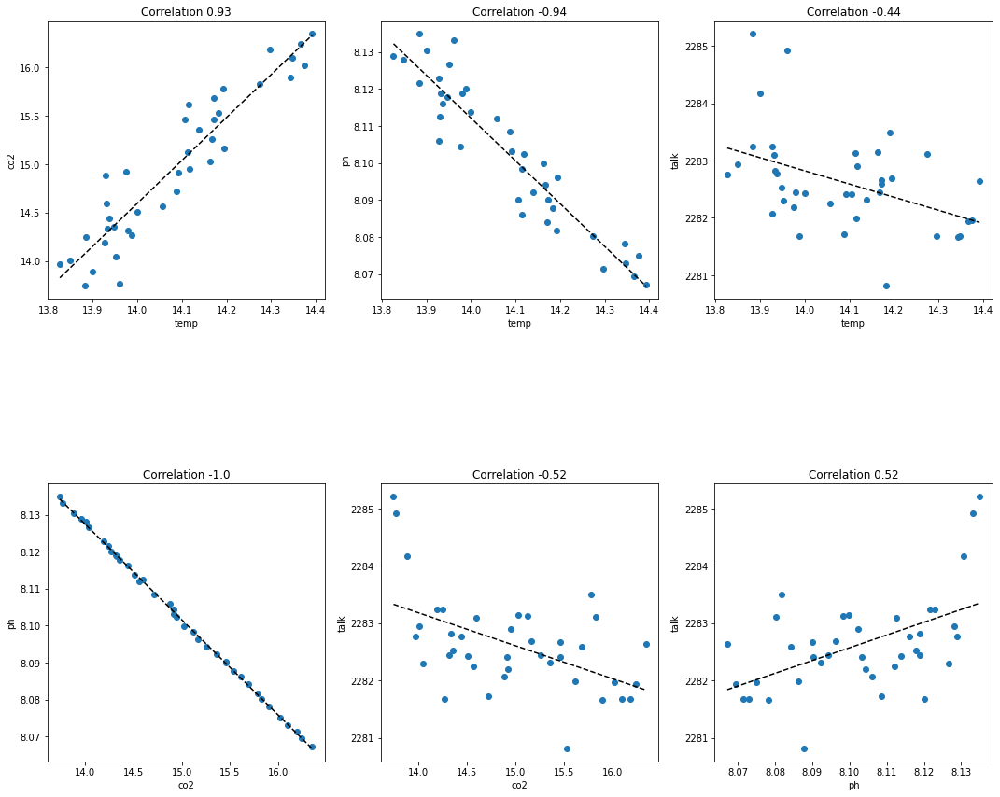

In [ ]:
#@title Correlation plots
variables = ["avg_temp", "avg_co2", "avg_ph", "avg_talk"]

fig, ax = plt.subplots(2,3, figsize = (15,15))
i = 0
j = 0
for idx, var1 in enumerate(variables):
  for var2 in variables[idx:]:
    if var1 != var2:
      if j > 2:
        j = 0
        i += 1
      axes = ax[i,j]
      coef = np.polyfit(df_avg[var1],df_avg[var2],1)
      poly1d_fn = np.poly1d(coef) 
      x = np.sort(df_avg[var1])
      axes.plot(x, poly1d_fn(x), '--k') 
      axes.scatter(df_avg[var1], df_avg[var2])
      axes.set_xlabel(var1[4:])
      axes.set_ylabel(var2[4:])
      axes.set_title("Correlation " + str(round(np.corrcoef(df_avg[var1], df_avg[var2])[0][1], 2)))
      axes.set_aspect(1.0/axes.get_data_ratio(), adjustable='box') # make square plot
      j += 1

plt.tight_layout()
plt.show()


It is clearly seen in the figure above that temperature, CO2 and pH are correlated. The strongest correlation is seen between pH and CO2, where an increase in CO2 causes a decrease in pH, hence a strong negative correlation. The CO2 from the atmosphere is dissolved in seawater, thereby decreasing the pH. The increase in atmospheric CO2 over time will therefore be linked to a corresponding decrease in pH. For the dataset used to contruct these visualizations, the pH variable is actually calculated directly from the measured CO2. The reason the two variables are not completely correlated, might be due to rounding of the calculated pH. The average temperature and CO2 are also correlated, showing increasing temperature relating to increasing CO2.

With global warming, it seems that the increasing temperature and CO2 will almost certainly decrease the pH levels of the water. The negative effects of the ocean acidification is not only limited to the corals, but affects these directly by removing carbonate, which is a calcifying agent needed to build and maintain the skeleton of the corals. These effects, along with the temperature increase, compound to diminish the chances coral reefs have of surviving global warming.

The most interesting correlation here is the average temperature and average CO2 as these are from measured values. There seems to be a strong correlation between these as would be expected from a climate change perspective. 

The rest of the correlations reveal what has already been discussed; namely that pH is calculated from CO2, which is why the correlation is almost perfect. This is also the reason why the correlation in the Figures CO2 vs. Alkalinity and pH vs. Alkalinity are symmetric.

It would seem that some of these visualisations are not useful, but the information gained is that it can be difficult to find causality between variables. It is not trivial that pH is not a measured value, but finding this can be important for latter conclusions. Therefore, exhaustive examination is necessary for a clear analysis in order to better understand the dynamics of the oceans and coral reefs.

From the previous figures it was seen that the average yearly temperature increases over time, but is this really the case everywhere on the globe?

To help better understand the change in temperature over time the figure below depicts the temperature as a function of latitude, with latitude ranging from 90 at the North Pole to -90 at the South Pole, making 0 the location of the Equator. In the first plot the yearly maximum, mean and minimum are calculated at all measured latitudes, and show the range of temperatures at all latitudes as well.

In order to depict the general change in temperature over the years the temperature and latitude data of each selected range of years was fitted to a second order polynomial. The difference in temperature are small relative to the normal range of temperature, meaning the difference between the ranges of years might be of more interest. The difference in temperature is calculated as the fitted curve for the range of years minus the fitted curve for the period from 1982 to 1990.


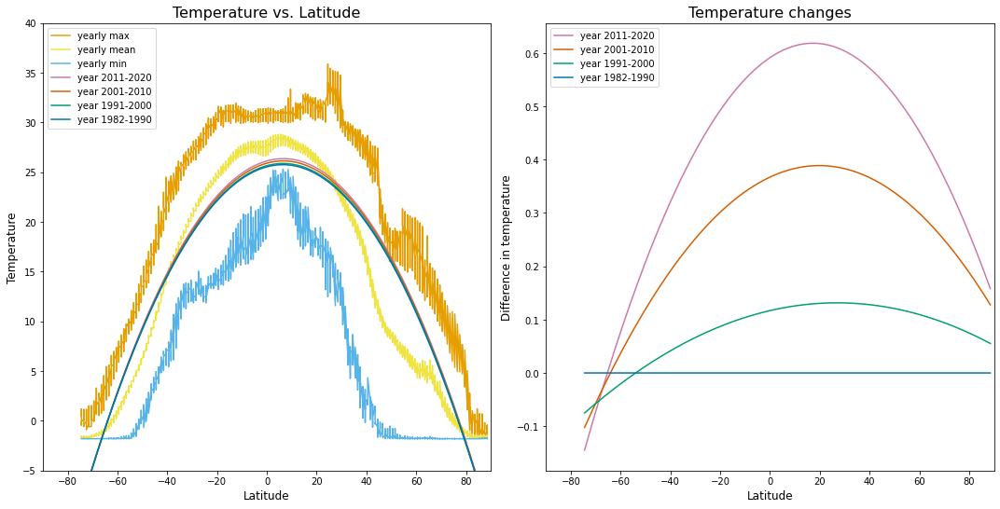

In [ ]:
#@title Temperature vs. Latitude
# extract years
years = df_oceanSODA.year.unique()

# group by year
ten1 = years[0:9]
ten2 = years[9:19]
ten3 = years[19:29]
ten4 = years[29:len(years)]

# calculate yearly max, min and mean for each measured latitude
maxs = df_oceanSODA.groupby(['lat', 'year'])["temperature"].max()
mins = df_oceanSODA.groupby(['lat', 'year'])["temperature"].min()
means = df_oceanSODA.groupby(['lat', 'year'])["temperature"].mean()

# latitudes
lats = df_oceanSODA.lat.unique()
lat_plot = np.linspace(-90, 90, num=(90+90+1), endpoint=True, retstep=False, dtype=None, axis=0)

fig, axes = plt.subplots(1,2,figsize = (15,10))

FS = 12 # font size
col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

# PLOT 1 - temperature
ax = axes[0]

# max, mean and min temperature
ax.plot(np.repeat(lats, len(years)),maxs, label = "yearly max",color = col[1])
ax.plot(np.repeat(lats, len(years)),means, label = "yearly mean",color = col[2])
ax.plot(np.repeat(lats, len(years)),mins, label = "yearly min",color = col[4])

# fitted lines
df = df_oceanSODA[df_oceanSODA.isin({'year': ten4}).year]
fit = np.polyfit(df.lat,df.temperature,2) # 2nd order polynomial fit
ax.plot(lat_plot,np.polyval(fit, lat_plot),color = col[6], label = "year 2011-2020")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten3}).year]
fit = np.polyfit(df.lat,df.temperature,2) # 2nd order polynomial fit
ax.plot(lat_plot,np.polyval(fit, lat_plot),color = col[5], label = "year 2001-2010")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten2}).year]
fit = np.polyfit(df.lat,df.temperature,2) # 2nd order polynomial fit
ax.plot(lat_plot,np.polyval(fit, lat_plot),color = col[3], label = "year 1991-2000")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten1}).year]
fit = np.polyfit(df.lat,df.temperature,2) # 2nd order polynomial fit
ax.plot(lat_plot,np.polyval(fit, lat_plot),color = col[0], label = "year 1982-1990")

# SETTINGS
ax.set_xlabel("Latitude", fontsize = FS)
ax.set_ylabel("Temperature", fontsize = FS)
ax.set_xlim([-90, 90])
ax.set_ylim([-5, 40])
ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box') # make square plot
ax.legend(loc="upper left")
ax.set_title('Temperature vs. Latitude', fontsize=16)


# PLOT 2 - difference in temperature
ax = axes[1]

# reference fit
df = df_oceanSODA[df_oceanSODA.isin({'year': ten1}).year]
X = df.lat
Y = df.temperature
fit_ref = np.polyfit(X,Y,2) # 2nd order polynomial fit

df = df_oceanSODA[df_oceanSODA.isin({'year': ten4}).year]
X = df.lat
Y = df.temperature
fit = np.polyfit(X,Y,2) # 2nd order polynomial fit
r = np.polyval(fit_ref, X)
ax.plot(X,np.polyval(fit, X)-r,color = col[6], label = "year 2011-2020")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten3}).year]
X = df.lat
Y = df.temperature
fit = np.polyfit(X,Y,2) # 2nd order polynomial fit
r = np.polyval(fit_ref, X)
ax.plot(X,np.polyval(fit, X)-r,color = col[5], label = "year 2001-2010")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten2}).year]
X = df.lat
Y = df.temperature
fit = np.polyfit(X,Y,2) # 2nd order polynomial fit
r = np.polyval(fit_ref, X)
ax.plot(X,np.polyval(fit, X)-r,color = col[3], label = "year 1991-2000")

df = df_oceanSODA[df_oceanSODA.isin({'year': ten1}).year]
X = df.lat
Y = df.temperature
fit_ref = np.polyfit(X,Y,2) # 2nd order polynomial fit
r = np.polyval(fit_ref, X)
ax.plot(X,np.polyval(fit_ref, X)-r,color = col[0], label = "year 1982-1990")


# SETTINGS
ax.set_xlabel("Latitude", fontsize = FS)
ax.set_ylabel("Difference in temperature", fontsize = FS)
ax.set_xlim([-90, 90])
ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box') # make square plot
ax.set_title('Temperature changes', fontsize=16)
ax.legend(loc="upper left")

plt.tight_layout()
plt.show()

The yearly max, mean and min temperature show that the general temperature range is around 10 degrees at most latitudes. As expected higher temperatures are seen around the equator, lowering towards the North and South Poles.
A quite small range of temperature can be seen at latitudes of 0 to 10, where it only changes around 7 degrees. The water temperature in these areas can therefore be expected to be both higher and more constant than other regions of the globe.

The temperature differences for the fitted curves show an overall steady increase in temperature over time, but also that the overall increase in temperature is not equal across the globe. The increase in temperature is much lower towards the poles and is highest around the Equator and further north to latitudes of around 40.

The subject of our focus later, the Great Barrier Reef, has a latitude of around -16.4, meaning it is well within the range of latitudes that have seen a yearly increase in temperature of roughly 0.2 degrees celsius between the last two decades. If nothing is done to prevent it, the pattern would suggest that these areas would see further increase in temperature in the next decades.

In order to investigate the connection between temperature, latitude and bleaching alerts further, the figure below can be examined. Here the first graph shows the max, mean and min yearly temperature as a function of latitude as seen previously. On this first graph all bleaching alerts of levels 1-4 are plotted as a function of the corresponding temperature and latitude of the individual bleaching alerts. The plot is interactive such that individual bleaching alert levels can be hidden.

In [ ]:
#@title Temperature and BAA
# Bleaching alert plot

# PLOT 1
p1 = figure(plot_height=500, plot_width=550,
             title='Bleaching alerts over temperature and latitude',
             x_axis_label = "Latitude", y_axis_label='Temperature',
             toolbar_location=None, x_range=Range1d(-50,50), y_range = Range1d(10, 40))

p1.x_range = Range1d(-50, 50) 
df = df_noaa[df_noaa.isin({'BAA_7day_max': [1]}).BAA_7day_max]
p1.circle(x = df["Polygon_Middle_Latitude"], y = df["SST@90th_HS"], color = col[0], alpha = 0.3, muted_alpha=0.01, width = 0.5, legend_label = "Alert lvl. 1")
df = df_noaa[df_noaa.isin({'BAA_7day_max': [2]}).BAA_7day_max]
p1.circle(x = df["Polygon_Middle_Latitude"], y = df["SST@90th_HS"], color = col[2], alpha = 0.3, muted_alpha=0.01, width = 0.5, legend_label = "Alert lvl. 2")
df = df_noaa[df_noaa.isin({'BAA_7day_max': [2]}).BAA_7day_max]
p1.circle(x = df["Polygon_Middle_Latitude"], y = df["SST@90th_HS"], color = col[6], alpha = 0.3, muted_alpha=0.01, width = 0.5, legend_label = "Alert lvl. 3")
df = df_noaa[df_noaa.isin({'BAA_7day_max': [2]}).BAA_7day_max]
p1.circle(x = df["Polygon_Middle_Latitude"], y = df["SST@90th_HS"], color = col[5], alpha = 0.3, muted_alpha=0.01, width = 0.5, legend_label = "Alert lvl. 4")

# max, mean and min
p1.line(np.repeat(lats, len(years)),maxs, legend_label = "yearly max", color = col[1])
p1.line(np.repeat(lats, len(years)),means, legend_label = "yearly mean", color = col[2])
p1.line(np.repeat(lats, len(years)),mins, legend_label = "yearly min", color = col[4])

p1.legend.location = "top_left"
p1.legend.click_policy="hide"


# PLOT 2
# bleaching alert vs. temperature - boxplot
cats = list("01234")
df = df_noaa[["SST@90th_HS","BAA_7day_max"]]
df = df.rename(columns={"SST@90th_HS":"score"})

# find the quartiles and IQR for each category
groups = df.groupby('BAA_7day_max')
q1 = groups.quantile(q=0.25)
q2 = groups.quantile(q=0.5)
q3 = groups.quantile(q=0.75)
iqr = q3 - q1
upper = q3 + 1.5*iqr
lower = q1 - 1.5*iqr

# find the outliers for each category
def outliers(group):
    cat = group.name
    return group[(group.score > upper.loc[cat]['score']) | (group.score < lower.loc[cat]['score'])]['score']
out = groups.apply(outliers).dropna()

# prepare outlier data for plotting, we need coordinates for every outlier.
if not out.empty:
    outx = list(out.index.get_level_values(0)+0.5)
    outy = list(out.values)

p2 = figure(plot_height=500, plot_width=400,
             title='Bleaching alerts over temperature and latitude',
             x_axis_label = "Bleaching alert level", y_axis_label='Temperature',
             toolbar_location=None,x_range=cats, y_range = Range1d(10, 40))

#p = figure(tools="", background_fill_color="#efefef", x_range=cats, toolbar_location=None)

# if no outliers, shrink lengths of stems to be no longer than the minimums or maximums
qmin = groups.quantile(q=0.00)
qmax = groups.quantile(q=1.00)
upper.score = [min([x,y]) for (x,y) in zip(list(qmax.loc[:,'score']),upper.score)]
lower.score = [max([x,y]) for (x,y) in zip(list(qmin.loc[:,'score']),lower.score)]

# stems
p2.segment(cats, upper.score, cats, q3.score, line_color="black")
p2.segment(cats, lower.score, cats, q1.score, line_color="black")

# boxes
p2.vbar(cats, 0.7, q2.score, q3.score, fill_color="#E08E79", line_color="black")
p2.vbar(cats, 0.7, q1.score, q2.score, fill_color="#3B8686", line_color="black")

# whiskers (almost-0 height rects simpler than segments)
p2.rect(cats, lower.score, 0.2, 0.01, line_color="black")
p2.rect(cats, upper.score, 0.2, 0.01, line_color="black")

# outliers
if not out.empty:
    p2.circle(outx, outy, size=6, color="#F38630", fill_alpha=0.6)

p2.xgrid.grid_line_color = None
p2.ygrid.grid_line_color = "white"
p2.grid.grid_line_width = 2
p2.xaxis.major_label_text_font_size="16px"

p = row(p1, p2)

show(p)

The bleaching alert temperature is from the NOAA dataset, and the temperature measurements can therefore be different than those obtained from the global dataset. This can be seen when comparing the bleaching alerts and the yearly max, where no bleaching alert should be able to have a temperature greater than the yearly maximum temperature. Taking into account the slight measuring difference most bleaching alerts seem to fall in between the mean and max yearly temperature, showing that bleaching alerts are strongly classified based on temperature. This is as expected, since the bleaching alerts are defined based on the temperature. The plot also shows that the measurement stations covers most of the globe within the latitudinal range of -32 to 32.

The plotted bleaching alerts shows the dependence of mean temperature in detemining the bleaching alert. The same temperature does not equal the same bleaching alerts level, since it is the relative local change in temperature that determines the severity of the expected bleaching.

The second graph of the figure shows boxplots of each of the bleaching alert levels 0-4 as a function of temperature. These show that only based on temperature, bleaching alert level 1-4 seem to have very similar range and distribution of points. Bleaching alert level 0 encompasses more of the lower temperatures, the lowest being around 15 degrees celsius.

Taking a closer look at the bleaching alert, we can use the figure below to investigate the seasonal trends. The figure shows the amount of alerts for each specific day of the year.

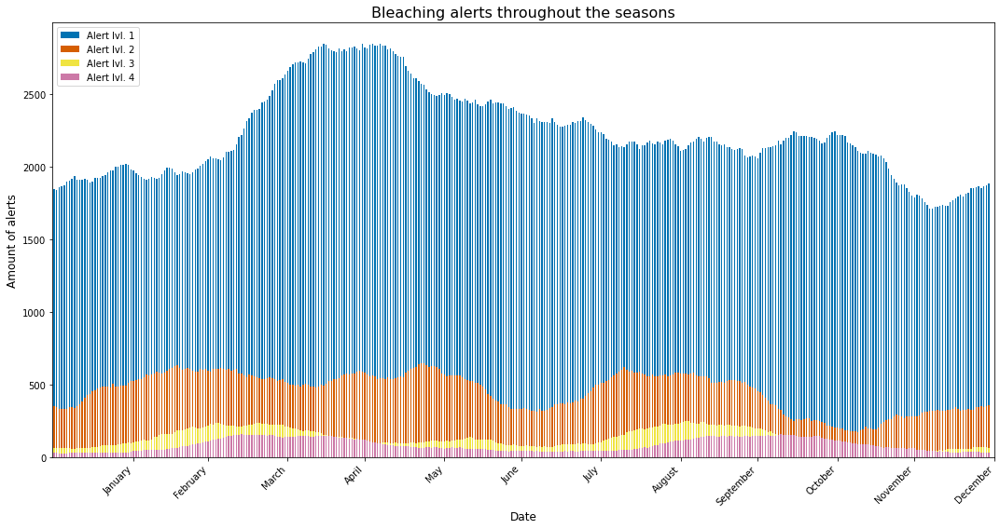

In [ ]:
#@title bleaching alerts vs. date [entire year]
fig, ax = plt.subplots(figsize=(15, 8))
cat = [1,2,3,4]
days_per_month = [31,29,31,30,31,30,31,31,30,31,30,31]
dates = np.cumsum(days_per_month)

months = ["January","February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]

df_focus = df_noaa.loc[(df_noaa["MM"] != 2) | (df_noaa["DD"] != 29)]

color = [col[0],col[5],col[2],col[6]]
for (ID, group) in df_focus[df_focus["BAA_7day_max"].isin(cat)].groupby("BAA_7day_max"):
    group[["MM","DD"]].value_counts().sort_index().plot.bar(ax = ax,color = color[ID-1])

ax.set_xlabel('Date', fontsize = 12)
ax.set_ylabel('Amount of alerts', fontsize = 12)
ax.legend(["Alert lvl. 1","Alert lvl. 2","Alert lvl. 3","Alert lvl. 4"],loc="upper left")
plt.xticks(dates, months, rotation=45, ha = "right")
plt.title("Bleaching alerts throughout the seasons", fontsize = 16)
plt.tight_layout()
plt.show()

The months from January to May seem to experience more bleaching alerts, but the most interesting trend is that level 4 alerts follows the same trend as the seasonal trend of temperature from [section 1](#part1). Here it was seen that highest amount of level 4 alerts occurred around March and September. This further cements the problem of temperature changes being the main driver of bleaching issues in coral reefs.

At this point, one could wonder about the effects of direct human interactions on the coral reefs. Global disturbances such as fishing and tourism are known to be some of the human [interactions](#https://oceanservice.noaa.gov/facts/coral-overfishing.html) that could possibly affect the coral reefs.

In the following section it will be investigated whether these problems have an effect on bleaching alerts, as well as some of the socioeconomic consequences derived from coral reef bleaching.

## Part 3: Social Effects of Coral Bleaching <a name="part3"></a>

[Table of Contents](#contents)

****


Coral reefs are not only a part of an symbiotic ocean ecosystem, balancing fish life and ocean climate, but also play a role in the socioeconomic system important to humans, both in terms of life enrichment as well as livelihood.

The following figure was created by [*Resource Watch*](https://resourcewatch.org/data/explore/fe9b286f-4b28-409a-85f5-2e81b2bd5056?hash=layers&section=All+data&selectedCollection=&zoom=0.406404332341255&lat=0&lng=-97.42372375294275&pitch=0&bearing=0&basemap=dark&labels=light&layers=%255B%257B%2522dataset%2522%253A%2522fe9b286f-4b28-409a-85f5-2e81b2bd5056%2522%252C%2522opacity%2522%253A1%252C%2522layer%2522%253A%2522b3bdc1b3-807a-468a-9ff5-c62733321ef6%2522%257D%255D&aoi=&page=1&sort=most-viewed&sortDirection=-1&topics=%255B%2522economic%2522%255D) 
using information on peoples' and countries' reliability on coral reefs.

The three categories used are:

1. Social and Economic Dependence on Coral Reefs
2. Vulnerability to Reef Loss
3. Adaptation Capacity to Reef Loss


All of these categories are computed using information on population, fishery employment, reef-exports, nutritional dependency, tourism, economics, resources and life expectancy, among others.
These give a rather interesting insight into different countries' dependency of coral reefs. 
One could argue, for example, that life expectancy is not directly related to coral reefs, and hypothesize that a good healthcare system should count towards life expectancy more that factors relating to coral reefs.

The countries and areas with social and economic dependency on coral reefs are generally Asia, where smaller islands seems to be more reliant on the reefs.
This is not surprising as it could be assumed that a fishing and tourism are of big importance to the livelihood in these areas, given that there is not much landmass providing other resources.

The areas vulnerable to coral reef loss, thus, follow the places that are socioeconomically dependent on the reefs, especially islands.


In [ ]:
#@title Choroplet maps of social aspects
from bokeh.models import Div

#output_file('dashboardWithFoliumMap.html')

map1 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_dependence_map.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")
map2 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_vulnerability_map.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")
map3 = Div(text="<iframe src="+'https://gmldtu.github.io/SocialData2022/folium_adaptability_map.html'" style='min-width:calc(100vw - 26px); height: 500px; border: 0px'><iframe>")

tab1 = Panel(child = map1, title = "Social and Economic Dependence to Reef Loss")
tab2 = Panel(child = map2, title = "Vulnerability to Reef Loss")
tab3 = Panel(child = map3, title = "Adaptation Capacity to Reef Loss")

show(Tabs(tabs=[tab1, tab2, tab3]))

One of the factors in the economic dependence of coral reefs are fishing, as it is important for some communities as discussed aboved. 

Here it is visualized how many tonnes of fish are reported each year in two opposite regions of the world where coral reefs are located, Cuba and Hong Kong. 
To compare how the bleaching alerts develop in the period and location, the alerts are also included.

In Central America, the fish caught are mostly represented by industrial fisheries, where there seems to be a slowdown in catches in the latter years. However, for Hong Kong no discernible pattern can be found, as industrial and non-industrial fishing seems to wobble every year, independently of the situation of the corals.


In [ ]:
#@title Bleaching alerts vs fishing data (examples of individual stations)
station_set = ['Southwestern Cuba','Hong Kong, China']
tabs = []

for station in station_set:
  df_station = df_noaa[df_noaa['Location'] == station]

  bal0 = []; bal1 = []; bal2 = []; bal3 = []; bal4 = [];
  for year in df_station["YYYY"].unique():
    alert_df = df_station[df_station["YYYY"] == year]
    bal0.append(len(alert_df[alert_df["BAA_7day_max"] == 0]))
    bal1.append(len(alert_df[alert_df["BAA_7day_max"] == 1]))
    bal2.append(len(alert_df[alert_df["BAA_7day_max"] == 2]))
    bal3.append(len(alert_df[alert_df["BAA_7day_max"] == 3]))
    bal4.append(len(alert_df[alert_df["BAA_7day_max"] == 4]))

  df_bal_station = pd.DataFrame({"bal0": bal0, "bal1": bal1, "bal2": bal2, "bal3": bal3, "bal4": bal4, "year": df_noaa["YYYY"].unique()})

  bal_fraction = [];
  for i in range(len(bal0)):
    amount = bal1[i] + bal2[i] + bal3[i] + bal4[i]
    if amount > 0:
      bal_fraction.append([100*bal1[i] / amount , 100*bal2[i] / amount, 100*bal3[i] / amount, 100*bal4[i] / amount])
    else:
      bal_fraction.append([0, 0, 0, 0])
  bal_fraction = np.array(bal_fraction)

  df_bal_station["bal1_frac"] = bal_fraction[:,0]
  df_bal_station["bal2_frac"] = bal_fraction[:,1]
  df_bal_station["bal3_frac"] = bal_fraction[:,2]
  df_bal_station["bal4_frac"] = bal_fraction[:,3]

  cds_bal = ColumnDataSource(data = df_bal_station)
  col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

  txt_size = "12pt"
  ####
  p1 = figure(plot_height=300, plot_width=450,
              title='Yearly accumulated bleaching alerts',
              x_axis_label = "Year", y_axis_label='Amount of alerts',
              toolbar_location=None)

  #ax1.y_range = Range1d(0, 32000) 

  p1.vbar_stack(['bal1','bal2','bal3','bal4'],x = "year",source = df_bal_station, \
                color=[col[0],col[5],col[2],col[6]], width = 0.5, \
                legend = ['Alert lvl. 1','Alert lvl. 2','Alert lvl. 3','Alert lvl. 4'])
  
  p1.legend.location = "top_left"
  p1.legend.click_policy="mute"

  tt = [
  ('Year', '@year'),
  ('% Level 1 Alerts', '@bal1_frac{0}%'),
  ('% Level 2 Alerts', '@bal2_frac{0}%'),
  ('% Level 3 Alerts', '@bal3_frac{0}%'),
  ('% Level 4 Alerts', '@bal4_frac{0}%') 
  ]

  p1.add_tools(HoverTool(tooltips=tt))

  ####

  dfg_focus = df_gfc[(df_gfc['LonWest'] <= df_station['Polygon_Middle_Longitude'].max()) \
                        & (df_gfc['LonEast'] >= df_station['Polygon_Middle_Longitude'].min()) \
                        & (df_gfc['LatSouth'] <= df_station['Polygon_Middle_Latitude'].max()) \
                        & (df_gfc['LatNorth'] >= df_station['Polygon_Middle_Latitude'].min()) ]

  dfg_focus['Tonnes_per_Station'] = dfg_focus['Tonnes_Reported'] * 25 / dfg_focus['OceanAreaSqkm']

  bfg0 = []; bfg1 = [];
  for year in df_gfc["Year"].unique():
    fishing_df = dfg_focus[dfg_focus["Year"] == year]
    bfg0.append(sum(fishing_df[fishing_df["Type"] == "Industrial"]['Tonnes_per_Station']))
    bfg1.append(sum(fishing_df[fishing_df["Type"] == "Non Industrial"]['Tonnes_per_Station']))

  df_bfg_station = pd.DataFrame({"bfg0": bfg0, "bfg1": bfg1, "year": df_gfc["Year"].unique()})

  bfg_fraction = [];
  for i in range(len(bfg0)):
    amount = bfg0[i] + bfg1[i]
    if amount > 0:
      show_fishing_data = True
      bfg_fraction.append([100*bfg0[i] / amount, 100*bfg1[i] / amount])
    else:
      show_fishing_data = False
      bfg_fraction.append([0, 0])
  bfg_fraction = np.array(bfg_fraction)

  df_bfg_station["bfg0_frac"] = bfg_fraction[:,0]#[0:-2]
  df_bfg_station["bfg1_frac"] = bfg_fraction[:,1]#[0:-2]

  #plot
  cds_bfg = ColumnDataSource(data = df_bfg_station)
  col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

  txt_size = "12pt"
  ####

  if show_fishing_data:
    p2 = figure(plot_height=300, plot_width=450,
                title='Yearly accumulated fishing tonnes',
                x_axis_label = "Year", y_axis_label='Tonnes per km2',
                toolbar_location=None)

    #ax1.y_range = Range1d(0, 32000) 

    p2.vbar_stack(['bfg0','bfg1'],x = "year",source = df_bfg_station, \
                  color=[col[0],col[5]], width = 0.5, \
                  legend = ['Industrial','Non-industrial'])

    p2.legend.location = "top_right"
    p2.legend.click_policy="mute"

    tt = [
    ('Year', '@year'),
    ('% of Industrial Fishing', '@bfg0_frac{0}%'),
    ('% of Non-industrial Fishing', '@bfg1_frac{0}%')
    ]

    p2.add_tools(HoverTool(tooltips=tt))

    p_row = row(p1, p2)
  else:
    p_row = row(p1)

  tab = Panel(child = p_row, title = station)
  tabs.append(tab)

show(Tabs(tabs=tabs))

## Part 4: Case Study, Great Barrier Reef <a name="part4"></a>

[Table of Contents](#contents)
****

The Great Barrier Reef (GBR) is the largest coral reef system in the world and one of the few included in the [UNESCO World Heritage List](https://whc.unesco.org/en/list/?&). The GBR is located off the coast of Queensland in the north-eastern part of Australia. Due to its large area, the BGR is split into sub-areas included as separate tabs in the figure below. The figure shows yearly accumulated bleaching alert, in comparison with fishing data, where available.

Some of the areas do not have fishing data available within the proximity of the reef, namely *Far Northern GBR* and *Central GBR*. The measurements stations at the different GBR reef locations cover the area within a 5 km radius from the station. Lack of fishing data at these stations therefore simply means no fishing has been logged within a 5 km proximity of the station.

Note that in order to better show the smaller range of yearly fishing in tonnes, the upper y-axis limit is changed from 50 to 5 in the plots for Northern and Southern Coral Sea Islands. Also note that the yearly bleaching alerts span from 1986 to 2020 whereas fishing data is only available from 1986 until 2015. Additionally 0 counts are shown as a minimal bar height to indicate that data is not missing but the true counts is 0. Using the hovertool on the plots these categories with 0 counts for the specific year will additionally show 0%.

In [ ]:
#@title Bleaching alert data vs fishing data in GBR stations
station_set = ['Torres Strait','Far Northern GBR','Northern GBR','Central GBR','Southern GBR','Northern Coral Sea Islands','Southern Coral Sea Islands']
tabs = []
tabs_no = []
YLIM_ALERT = [200,200,200,200,200,200,200]
YLIM_FISH = [60,60,60,60,60,6,6]

IDX = 0
for station in station_set:
  df_station = df_noaa[df_noaa['Location'] == station]

  bal0 = []; bal1 = []; bal2 = []; bal3 = []; bal4 = [];
  for year in df_station["YYYY"].unique():
    alert_df = df_station[df_station["YYYY"] == year]
    bal0.append(len(alert_df[alert_df["BAA_7day_max"] == 0]))
    bal1.append(len(alert_df[alert_df["BAA_7day_max"] == 1]))
    bal2.append(len(alert_df[alert_df["BAA_7day_max"] == 2]))
    bal3.append(len(alert_df[alert_df["BAA_7day_max"] == 3]))
    bal4.append(len(alert_df[alert_df["BAA_7day_max"] == 4]))

  df_bal_station = pd.DataFrame({"bal0": bal0, "bal1": bal1, "bal2": bal2, "bal3": bal3, "bal4": bal4, "year": df_noaa["YYYY"].unique()})

  bal_fraction = [];
  for i in range(len(bal0)):
    amount = bal1[i] + bal2[i] + bal3[i] + bal4[i]
    if amount > 0:
      bal_fraction.append([100*bal1[i] / amount , 100*bal2[i] / amount, 100*bal3[i] / amount, 100*bal4[i] / amount])
    else:
      bal_fraction.append([0, 0, 0, 0])
  bal_fraction = np.array(bal_fraction)

  df_bal_station["bal1_frac"] = bal_fraction[:,0]
  df_bal_station["bal2_frac"] = bal_fraction[:,1]
  df_bal_station["bal3_frac"] = bal_fraction[:,2]
  df_bal_station["bal4_frac"] = bal_fraction[:,3]

  cds_bal = ColumnDataSource(data = df_bal_station)
  col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

  txt_size = "12pt"
  ####
  p1 = figure(plot_height=300, plot_width=450,
              title='Yearly bleaching alerts',
              x_axis_label = "Year", y_axis_label='Amount of alerts',
              toolbar_location=None)

  #ax1.y_range = Range1d(0, 32000) 

  p1.vbar_stack(['bal1','bal2','bal3','bal4'],x = "year",source = df_bal_station, \
                color=[col[0],col[5],col[2],col[6]], width = 0.5, \
                legend = ['Alert lvl. 1','Alert lvl. 2','Alert lvl. 3','Alert lvl. 4'])
  p1.y_range = Range1d(0, YLIM_ALERT[IDX])
  p1.legend.location = "top_left"
  p1.legend.click_policy="mute"

  tt = [
  ('Year', '@year'),
  ('% Level 1 Alerts', '@bal1_frac{0}%'),
  ('% Level 2 Alerts', '@bal2_frac{0}%'),
  ('% Level 3 Alerts', '@bal3_frac{0}%'),
  ('% Level 4 Alerts', '@bal4_frac{0}%') 
  ]

  p1.add_tools(HoverTool(tooltips=tt))

  ####

  dfg_focus = df_gfc[(df_gfc['LonWest'] <= df_station['Polygon_Middle_Longitude'].max()) \
                        & (df_gfc['LonEast'] >= df_station['Polygon_Middle_Longitude'].min()) \
                        & (df_gfc['LatSouth'] <= df_station['Polygon_Middle_Latitude'].max()) \
                        & (df_gfc['LatNorth'] >= df_station['Polygon_Middle_Latitude'].min()) ]

  dfg_focus['Tonnes_per_Station'] = dfg_focus['Tonnes_Reported'] * 25 / dfg_focus['OceanAreaSqkm']

  bfg0 = []; bfg1 = [];
  for year in df_gfc["Year"].unique():
    fishing_df = dfg_focus[dfg_focus["Year"] == year]
    bfg0.append(sum(fishing_df[fishing_df["Type"] == "Industrial"]['Tonnes_per_Station']))
    bfg1.append(sum(fishing_df[fishing_df["Type"] == "Non Industrial"]['Tonnes_per_Station']))

  df_bfg_station = pd.DataFrame({"bfg0": bfg0, "bfg1": bfg1, "year": df_gfc["Year"].unique()})

  bfg_fraction = [];
  for i in range(len(bfg0)):
    amount = bfg0[i] + bfg1[i]
    if amount > 0:
      show_fishing_data = True
      bfg_fraction.append([100*bfg0[i] / amount, 100*bfg1[i] / amount])
    else:
      show_fishing_data = False
      bfg_fraction.append([0, 0])
  bfg_fraction = np.array(bfg_fraction)

  df_bfg_station["bfg0_frac"] = bfg_fraction[:,0]#[0:-2]
  df_bfg_station["bfg1_frac"] = bfg_fraction[:,1]#[0:-2]

  #plot
  cds_bfg = ColumnDataSource(data = df_bfg_station)
  col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette

  txt_size = "12pt"
  ####

  if show_fishing_data:
    p2 = figure(plot_height=300, plot_width=450,
                title='Yearly fishing tonnes',
                x_axis_label = "Year", y_axis_label='Tonnes per km2',
                toolbar_location=None)

    #ax1.y_range = Range1d(0, 32000) 

    p2.vbar_stack(['bfg0','bfg1'],x = "year",source = df_bfg_station, \
                  color=[col[0],col[5]], width = 0.5, \
                  legend = ['Industrial','Non-industrial'])
    p2.y_range = Range1d(0, YLIM_FISH[IDX])
    p2.legend.location = "top_right"
    p2.legend.click_policy="mute"

    tt = [
    ('Year', '@year'),
    ('% of Industrial Fishing', '@bfg0_frac{0}%'),
    ('% of Non-industrial Fishing', '@bfg1_frac{0}%')
    ]

    p2.add_tools(HoverTool(tooltips=tt))

    p_row = row(p1, p2)
    tab = Panel(child = p_row, title = station)
    tabs.append(tab)
  else:
    p_row = row(p1)
    tab_no_fish = Panel(child = p_row, title = station )
    tabs_no.append(tab_no_fish)

  IDX+=1

show(Tabs(tabs=[tabs[0], tabs[1], tabs[2], tabs[3], tabs[4], tabs_no[0], tabs_no[1]]))

The overall amount of level 1 and 2 alerts of the GBR seem to have no general trend, but an increase in amount of level 4 alerts can be seen within recent years. No explanation was found for the lack of or small amounts of bleaching alerts for year 2000 at multiple locations.

From the figure above it can also be seen that from year 1999 the tonnes of fish catched drop drastically. It is hypothesized that this systematic change across all areas of the GBR is due to systematic changes in the fishing regulation. After 1998 there is no longer non-industrial fishing in any of the areas of the GBR.

For both the Southern and Northern Coral Sea Islands there have been no recordings of non-industrial fishing within the obtained dataset. In the Southern GBR the amount of non-industrial fishing is seen to decrease over time. For the remaining areas with fishing data, the ratio of industrial to non-industrial appears much more even. 

In general, less fishing is not seen as a bad thing for the corals, but only for the people who depend on the fishing industry for their livelihood or nutrition. It is assumed that the decreased amount of fish caught does not reflect an actual lack of fish in the areas, but of this we cannot be certain with the data at hand. No distinctive correlation was found between fishing and coral bleaching based on the visual assessment of the yearly data plotted in the figure.

There have been, in other reefs, been made connections between [tourism](https://earthjustice.org/blog/2016-april/coral-reefs-and-the-unintended-impact-of-tourism) and coral damage. Tourist visiting the reefs can directly impact the health of the corals by simply touching them or even breaking off parts of the reef. These actions can, to some degree, be purely due to the visitors' lack of knowledge on how to treat the reef. Pollution from tourists is also a factor, since they might drop trash into the water or not use [reef-safe sunscreen](https://savethereef.org/about-reef-save-sunscreen.html) when diving.

In [ ]:
#@title GBR tourism data
#cds_avg = ColumnDataSource(data = df_)
#cds_avg_month = ColumnDataSource(data = df_avg_month)
col = bokeh.palettes.all_palettes["Colorblind"][7] # set colorpalette
#months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

df_focus = df_tourism_gbr[df_tourism_gbr['Section'] == "ALL"]
df_focus = df_focus[df_focus['trip_year'] < 2021]
df_focus['CW_Percent'] = 100*df_focus['Coral_Viewing']/df_focus['Total_ALL']

txt_size = "12pt"

p1 = figure(plot_height=400, plot_width=600,
             title='Yearly tourism numbers in the Great Barrier Reef Marine Park',
             x_axis_label = "Year", y_axis_label='Visitors',
             toolbar_location=None)

#ax1.y_range = Range1d(0, 32000) 

p1.vbar_stack(['Total_ALL'],x = "trip_year", source = df_focus, \
              color=[col[2]], width = 0.5, \
              legend = ['Total Visitors'])

# Setting y-ranges
p1.y_range = Range1d(0, 3500000)  
p1.yaxis.axis_label_text_font_size = txt_size 
p1.yaxis.axis_label_text_color = col[0]
p1.yaxis.major_label_text_color = col[0]
#p1.extra_y_ranges = {"foo": Range1d(start=13, end=20)}
#p1.add_layout(LinearAxis(y_range_name="foo", axis_label='co2 [mmol/kg]', axis_label_text_color = col[1], major_label_text_color = col[1], axis_label_text_font_size = txt_size), 'right')
   
p1.line(x = "trip_year", y = "Coral_Viewing", source = df_focus, \
        color = col[5], legend="Coral Viewing Visitors")
p1.scatter(x = "trip_year", y = "Coral_Viewing", source = df_focus,  color = col[0])

p1.legend.location = "top_right"
p1.legend.click_policy="mute"

tt = [
('Year', '@trip_year'),
('% Coral Viewing', '@CW_Percent{0}%') 
]

p1.add_tools(HoverTool(tooltips=tt))

####
show(p1)

The total amount of yearly visitors at the Great Barrier Reef Marine Park is seen to increase over the years of 2012 to 2016 and then slightly decrease towards 2019. At 2020 we see a drastic decrease in yearly visitors assumed to be due to the beginning of the COVID disease, since WHO declared it a pandemic on the 11th of March 2020. The pandemic affected the freedom of movement through lockdowns which affected both international travel as well as regional tourism.

## Discussion and Conclusions <a name="part5"></a>

[Table of Contents](#contents)
****

To understand climate change and the many consequences, it is important to take many factors into account as the examined ecosystems and cause of change are very complex. In this case, it was very difficult to accurately conclude that anything other than climate change is the cause of coral bleaching and the growing concern of ocean lifes' eventual decline. It is therefore important to stress that it is not the purpose of this project to determine all the possible causes coral bleaching, as the dataset utilized here is already using temperature to determine coral stress. This research just showcases some of the aspects from coral bleaching, including possible socioeconomic consequences. It is clearly shown that a problem exists and continues to be of greater concern each year and possibly long into the future, if action to combat climate change is not taken soon. Bleaching of coral reefs is also shown to have negative consequences for human life, economically, in that fishing and tourism of coral reefs will be less viable in the future, if the reefs coverage recedes. Thus it cannot be concluded that tourism and fishing is as severe as climate change in the bleaching of coral reefs, but when socioeconomic wellbeing is dependent on such ecosystems, we are dealing with multifaceted complex problems, with more than one possible outcome.

Availability of data on coral reefs is somewhat limited; many datasets are estimated from in-situ measurements, which makes it difficult to get a good idea of the whole reef in question. In the [NOAA dataset](#) concerning bleaching alerts, the classification of alerts are based on temperature measurements, meaning other variables and impacts are difficult to attribute to this. In the environmental NOAA dataset, [OceanSODA](https://www.ncei.noaa.gov/data/oceans/ncei/ocads/metadata/0220059.html), many variables are determined from direct measurements, making it difficult to examine correlation and causality. This makes difficult to determine any real impact on the climate as these datasets are directly correlated to temperature as mentioned earlier. One thing that these datasets can be used for, as described above, is an overview of general trends in this complex system.

Data available from tourism industry is also scarce and plagued with limitations. Tourism datasets will often be local and not global, meaning it would take a strong and concerted effort to merge and consolidate datasets, the way it has been done with the fishing dataset. 

It could have been interesting to overlap coral coverage over time and the extend of fishing, tourism and pollution as well as temperature, in order to investigate the impact at a specific area instead of a general perspective. However, with the datasets at hand, possible relations are not specific enough to leverage significant insights or sometimes too general or large in scale, to accurately determine relations between corals, marine life and human populations.

## References <a name="references"></a>

[Table of Contents](#contents)
****
Datasets
- https://coralreefwatch.noaa.gov/product/vs/data.php
- https://www.ncei.noaa.gov/data/oceans/ncei/ocads/metadata/0220059.html
- https://metadata.imas.utas.edu.au/geonetwork/srv/eng/catalog.search#/metadata/5c4590d3-a45a-4d37-bf8b-ecd145cb356d
- https://resourcewatch.org/data/explore/bio031-Social-and-Economic-Dependence-on-Coral-Reefs_replacement?section=Discover
- https://www.gbrmpa.gov.au/our-work/Managing-multiple-uses/tourism-on-the-great-barrier-reef/numbers

Coral bleaching 
- https://oceanservice.noaa.gov/facts/coral_bleach.html

Coral bleaching - tourism 
- https://earthjustice.org/blog/2016-april/coral-reefs-and-the-unintended-impact-of-tourism

Coral bleaching - overfishing
- https://oceanservice.noaa.gov/facts/coral-overfishing.html

Climate change and acidification 
- https://www.noaa.gov/education/resource-collections/ocean-coasts/ocean-acidification
- https://www.climate.gov/news-features/understanding-climate/climate-change-atmospheric-carbon-dioxide
- https://www.irishtimes.com/news/environment/just-three-years-left-to-stop-worst-of-global-warming-un-body-warns-1.4844623
- https://www.fisheries.noaa.gov/insight/understanding-ocean-acidification
- https://agupubs.onlinelibrary.wiley.com/doi/epdf/10.1029/2019RG000681
- https://www.aims.gov.au/docs/research/climate-change/declining-coral-growth.html
- https://link.springer.com/content/pdf/10.1007/978-3-319-17446-4.pdf (Chapter 8)

General
- https://www.nesdis.noaa.gov/
- https://www.latlong.net/place/the-great-barrier-reef-australia-3899.html
- https://whc.unesco.org/en/list/?&
- https://en.wikipedia.org/wiki/Great_Barrier_Reef

Github repository
- https://github.com/gmlDTU/SocialData2022

Relevant files (Google Drive)
- https://drive.google.com/drive/folders/1mIe9onWp3WfR8jv9Y0fPatjCP3NMaBJq?usp=sharing

In [ ]:
%%shell
jupyter nbconvert /content/ProjectCoral.ipynb --no-input --to html

[NbConvertApp] Converting notebook /content/ProjectCoral.ipynb to html
[NbConvertApp] Writing 30978292 bytes to /content/ProjectCoral.html
